## Import

In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import itertools
import pickle as pk
from scipy.stats import binom
from scipy.stats import poisson
from scipy.stats import expon
from scipy import stats
from sklearn.cluster import KMeans
from collections import Counter

In [12]:
data = pd.read_csv('data/orginal_peak_BEH_0.1_all.csv')
data.shape

(1430077, 2)

In [13]:
data.columns = ['mz','int']
data['log_int'] = np.log10(data['int'])

data

,mz,int,log_int
0,400.0002,671.274658,2.826900
1,400.0004,1902.307678,3.279281
2,400.0005,1491.358765,3.173582
3,400.0006,6902.810181,3.839026
4,400.0007,12347.516785,4.091580
...,...,...,...
1430072,1997.1516,6008.619629,3.778775
1430073,1997.5312,3439.196045,3.536457
1430074,1997.7218,5176.346680,3.714023
1430075,1999.2694,6797.163086,3.832328


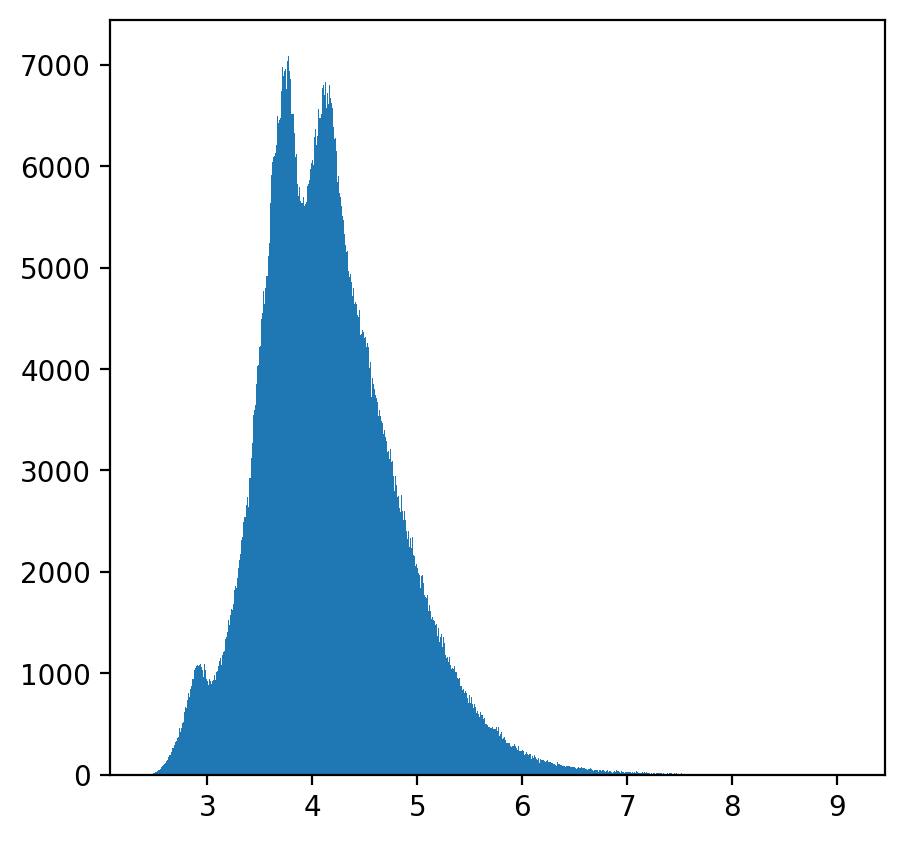

In [15]:
plt.figure(figsize=(5,5),dpi=200)
plt.hist(data['log_int'], bins=1000)
plt.show()

In [3]:
df= pd.read_csv('data/save_merged_BEH_peak2_ppm10_0.9test.csv',index_col=0)
df

,496.0072,497.0101,598.9488,434.061,559.9806,641.936,410.4668,751.9962,755.9951,773.9781,...,616.6436,638.6255,861.001,882.9829,621.9648,867.505,868.0065,878.9974,891.4869,896.9939
0,41144.789062,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,7914.327637,15989.049805,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,35553.601562,0.000000,0.000000,7628.526855,6276.306152,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,18274.021484,0.000000,0.000000,6841.540527,0.000000,0.000000,0.000000,0.000000,0.000000
2,48418.476562,0.000000,0.000000,5490.257812,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,10338.651367,10576.825195,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9665.966797
3,34026.003906,0.000000,0.000000,5979.180176,0.000000,5907.936523,0.000000,0.000000,0.000000,0.000000,...,6522.130859,26073.486328,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,48656.621094,18569.650391,0.000000,15713.559570,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,10850.341797,22737.583984,0.000000,0.000000,9129.040039,0.000000,14884.468750,0.000000,0.000000,0.000000
5,41288.921875,17723.347656,0.000000,14352.035156,0.000000,0.000000,0.000000,13494.277344,0.000000,0.000000,...,8889.952148,12746.931641,0.000000,0.000000,10477.463867,0.000000,17187.873047,0.000000,0.000000,0.000000
6,26864.982422,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8491.771484,0.000000,0.000000,...,0.000000,32510.966797,0.000000,0.000000,0.000000,0.000000,21029.957031,0.000000,0.000000,0.000000
7,40419.511719,11766.531250,0.000000,13573.376953,0.000000,0.000000,0.000000,9119.724609,0.000000,0.000000,...,0.000000,8509.845703,0.000000,0.000000,0.000000,8277.177734,7759.312012,0.000000,0.000000,10024.517578
8,56224.144531,9227.511719,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,8125.001465,0.000000,0.000000,0.000000,9311.533203,0.000000,0.000000,0.000000,19185.484375
9,44798.171875,21497.304688,0.000000,8330.361328,0.000000,0.000000,0.000000,8525.193359,0.000000,0.000000,...,0.000000,10708.295898,20542.964844,0.000000,0.000000,0.000000,20919.210938,13472.447266,0.000000,0.000000


In [7]:
kmeans = KMeans(n_clusters=5,random_state=10).fit(df.T)
label = kmeans.labels_
Counter(label)

Counter({0: 503, 1: 1, 2: 2, 4: 13, 3: 2})

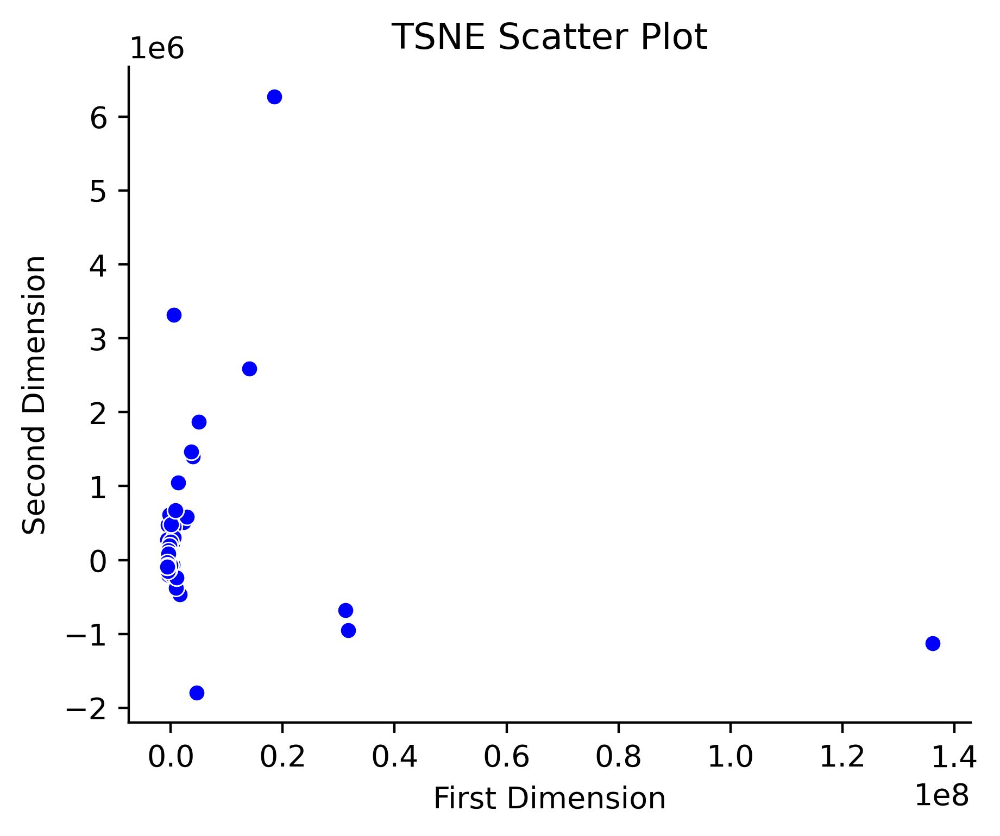

In [9]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, init='pca', random_state=0)
X_tsne = tsne.fit_transform(df.T)

# x_min, x_max = X_tsne.min(0), X_tsne.max(0)
# X_norm = (X_tsne - x_min) / (x_max - x_min)  # 归一化

colors = ['blue']
plt.figure(figsize=(5,4),dpi=400)
lb = label
for i in range(len(colors)):
    comp1 = X_tsne[:,0]
    comp2 = X_tsne[:,1]
    plt.scatter(comp1, comp2, c=colors[i],edgecolors='w',linewidths=0.5, s=30)
# plt.legend(['HC', 'OA', 'RA'], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0, frameon=False)
# plt.legend(['0', '1', '2'], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0, frameon=False)
plt.xlabel('First Dimension')
plt.ylabel('Second Dimension')
plt.title("TSNE Scatter Plot")
sns.despine()
plt.show()

In [8]:
label

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 2, 4, 4, 3, 4, 4, 0, 0, 4,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 4, 4, 0,
       0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

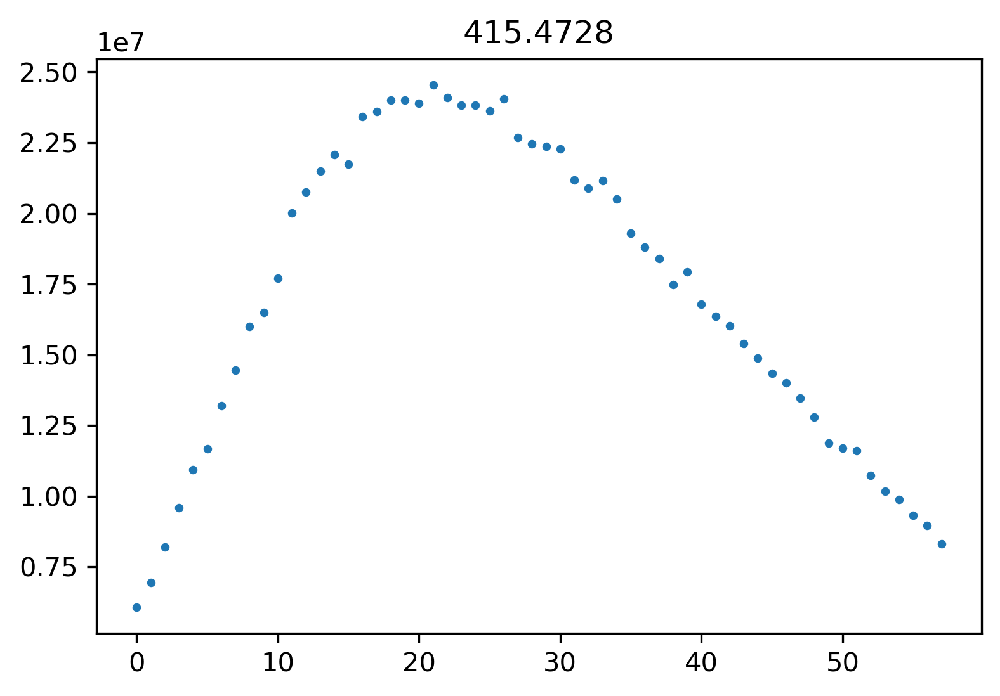

In [6]:
plt.figure(figsize=(6, 4),dpi=300)

x = range(df.shape[0])
y = df['415.4728']

plt.scatter(x,y, s=5)
plt.title('415.4728')
plt.show()

In [28]:
fig, axs = plt.subplots(10,8,figsize=(30, 30),dpi=300)
start = 480
col_name = df.columns[start:(start+80)]
x = range(df.shape[0])
for i in range(len(col_name)):
    n = col_name[i]
    y = df[n]
    a1 = (i)//8
    a2 = (i)%8
    axs[a1,a2].scatter(x,y, s=5)
    sns.despine()
    axs[a1,a2].set_title(n)
plt.tight_layout(pad=1) 
plt.show()

In [29]:

df= pd.read_csv('data/save_merged_BEH_peak39_ppm10_0.8test2.csv',index_col=0)
df

,841.745,842.2466,842.7479,843.2492,843.7505,853.2376,471.8392,523.3086,675.7653,862.7502,...,879.757,901.5384,906.5352,910.5318,919.5242,923.5203.1,928.5172,932.5137,946.3025,950.2989
0,122325.445312,123405.601562,72779.382812,11123.248047,3692.355713,0.000000,0.000000,0.000000,9824.124023,25641.425781,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,5919.298828
1,145067.609375,140714.156250,79920.773438,29014.107422,18908.625000,0.000000,0.000000,0.000000,0.000000,0.000000,...,15979.584961,18306.736328,14016.682617,0.0,0.000000,0.000000,8373.215820,0.000000,0.000000,5797.334473
2,0.000000,121565.414062,52778.808594,25118.476562,11624.990234,6328.038086,5365.981445,0.000000,0.000000,19956.949219,...,5780.439453,10743.879883,0.000000,0.0,0.000000,0.000000,0.000000,20896.068359,9282.479492,0.000000
3,113609.835938,101665.828125,56138.722656,27555.117188,3292.702148,10113.661133,0.000000,2874.239990,0.000000,21208.578125,...,8622.170898,0.000000,4154.078613,0.0,0.000000,0.000000,9186.050781,0.000000,14383.568359,5078.886230
4,152636.484375,139598.328125,61170.269531,30101.976562,0.000000,0.000000,5256.708008,6357.382324,9336.877930,0.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,4813.236328,5162.394043,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
220,10959.279297,9488.109375,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4893.670898,0.000000,...,11201.511719,0.000000,7999.947266,0.0,0.000000,11121.381836,0.000000,0.000000,0.000000,0.000000
221,4959.715332,4158.004395,2922.182617,2645.926514,0.000000,3068.875977,0.000000,0.000000,0.000000,0.000000,...,11813.616211,3964.084961,0.000000,0.0,2099.016113,0.000000,2340.190674,4960.202148,0.000000,0.000000
222,7875.284180,10142.199219,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3975.692383,0.000000,...,13420.137695,0.000000,0.000000,0.0,0.000000,4323.312988,0.000000,7479.826172,0.000000,0.000000
223,7284.582031,6739.508301,0.000000,0.000000,0.000000,3264.776367,0.000000,0.000000,4629.870117,3543.146240,...,0.000000,2981.307861,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [46]:
fig, axs = plt.subplots(10,8,figsize=(30, 30),dpi=300)
start = 27080
col_name = df.columns[start:(start+80)]
x = range(df.shape[0])
for i in range(len(col_name)):
    n = col_name[i]
    y = df[n]
    a1 = (i)//8
    a2 = (i)%8
    axs[a1,a2].scatter(x,y, s=5)
    sns.despine()
    axs[a1,a2].set_title(n)
plt.tight_layout(pad=1) 
plt.show()

## draw simulator data

In [195]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
import plotly.express as px



In [222]:
data = pd.read_csv('simulated_data/negative/noise_norm_8_2.csv', header=None)
print(data.shape)
print(data.iloc[0,0])
draw_data = []
for i in range(data.shape[0]):
    for j in range(1,data.shape[1]):
        v = data.iloc[i,j]
        if v>0.001:
            draw_data.append([i,j,v])
draw_df = pd.DataFrame(draw_data, columns=['x','y','z'])
draw_df['size'] = 3


(536, 242)
837.49514


### norm

In [161]:
# norm_0_2 m/z= 2121
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [164]:
# norm_1_8 m/z= 604
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [158]:
# norm_6_5 m/z= 753
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

### norm_overlap

In [167]:
# norm_overlap_1_4 m/z= 183
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [170]:
# norm_overlap_3_6 m/z= 136
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [173]:
# norm_overlap_7_1 m/z= 2796
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [194]:
# norm_0_5 m/z= 406
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

### gamma

In [197]:
# gamma
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [199]:
# gamma
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [201]:
# gamma
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

### noise

In [205]:
# noise
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [207]:
# noise
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

### noise_rand

In [209]:
# noise_rand
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [211]:
# noise_rand
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [215]:
# noise_rand
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

### noise_norm

In [219]:
# noise_norm
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [221]:
# noise_norm
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()

In [223]:
# noise_norm
df = draw_df
# fig = px.scatter_3d(df,x = df['x'], y = df['y'], z = df['z'], 
# size= df['size'],size_max=5,color=df['x'],opacity=0.9) #range_z=[0,1]
trace = go.Scatter3d(
x = df['x'], y = df['y'], z = df['z'],mode = 'markers', marker = dict(
size = 1.5,
color = df['x'],
colorscale='rainbow'
)
)
layout = go.Layout(title = '3D Scatter plot')
fig = go.Figure(data = [trace], layout = layout)
fig.update_layout(
    title_text='norm',
    height=800,
    width=1000,
    margin=dict(l=5, r=5, b=0, t=0))
fig.show()